Team Members:\
Aryaman Gokarn(506303588)\
Mugdha Bhagwat(606297799)\
Tania Rajabally(806153219)


# **Let’s Help Santa!**

In [ ]:
#Installing
!pip install python-igraph
!apt install libcairo2-dev pkg-config python3-dev
!pip install python-igraph leidenalg cairocffi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 11.1 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
pkg-config is already the newest version (0.29.2-1ubuntu3).
python3-dev is already the newest version (3.10.6-1~22.04).
python3-dev set to manually installed.
The following additional packages will be installed:
  libblkid-dev libblkid1 libcairo-script-interpreter2 libffi-dev libglib2.0-dev libglib2.0-dev-bin
  libice-dev liblzo2-2 libmount-dev libmount1 libpixman-1-dev libselinux1-dev libsepol-dev
  libsm-dev libxcb-render0-dev libxcb-shm0-dev
Suggested packages:
  libcairo2-doc libgirepository1.0-dev libglib2.0-doc libgdk-pixbuf2.0-bin | libgdk-pixbuf2.0-dev
  libxml2-utils libice-doc cryptsetup-bin libsm-doc
The following NEW packages will be installed:
  libblkid-dev libcairo-script-interpreter2 libcairo2-dev libffi-dev libglib2.0-dev
  libglib2.0-dev-bin libice-dev liblzo2-2 libmount-dev libpixman-1-dev libs

In [ ]:
#Imports
import numpy as np
import pandas as pd
import igraph as ig
import json
import csv
import matplotlib.pyplot as plt
import cairocffi
import networkx as nx
from scipy.spatial import Delaunay
from google.colab import drive
from copy import deepcopy

### QUESTION 9

In [ ]:
#mounting the drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#Reading the csv from drive and storing it in a dataframe
uber_data = pd.read_csv('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv', usecols=['sourceid', 'dstid', 'mean_travel_time', 'month'])
uber_data.shape

(5144062, 4)

In [ ]:
uber_data.head()

,sourceid,dstid,month,mean_travel_time
0,17,296,10,1109.36
1,28,186,10,1625.16
2,758,972,12,953.55
3,1212,547,10,2053.39
4,1299,1221,11,1467.54


In [ ]:
#Only using the data from the month of December
uber_data = uber_data[uber_data['month']==12][['sourceid','dstid','mean_travel_time']]
gd = uber_data.values
graph_dict = {}
#Finding the mean travelling time
for sourceid,dstid,mean_travel_time in gd:
    key = tuple(np.sort([int(sourceid), int(dstid)]))
    if key in graph_dict: graph_dict[key].append(mean_travel_time)
    else: graph_dict[key] = [mean_travel_time]

In [ ]:
#Storing the graph data in a file
with open('graph_data.txt','w') as f:
    for loc in graph_dict:
        f.write('{} {} {}\n'.format(loc[0], loc[1], np.mean(graph_dict[loc])))

g = ig.Graph.Read(f = 'graph_data.txt', format = 'ncol', directed = False)
#Creating the graph
gcc = g.components().giant()
print("The number of nodes in G are ",len(gcc.vs))
print("The number of edges in G are ",len(gcc.es))

The number of nodes in G are  2649
The number of edges in G are  1004955


QUESTION 9: Report the number of nodes and edges in G.

> The nodes represent geographic locations (latitude and longitude), and the edges denote average travel times between these locations. To simplify the graph, we remove isolated nodes, merge duplicate edges by averaging their weights, and retain only the largest connected component. We use the 'los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv' file to import the source ID, destination ID, and mean travel times for constructing the graph.

>The number of nodes in G are: 2649\
The number of edges in G are: 1004955


### QUESTION 10

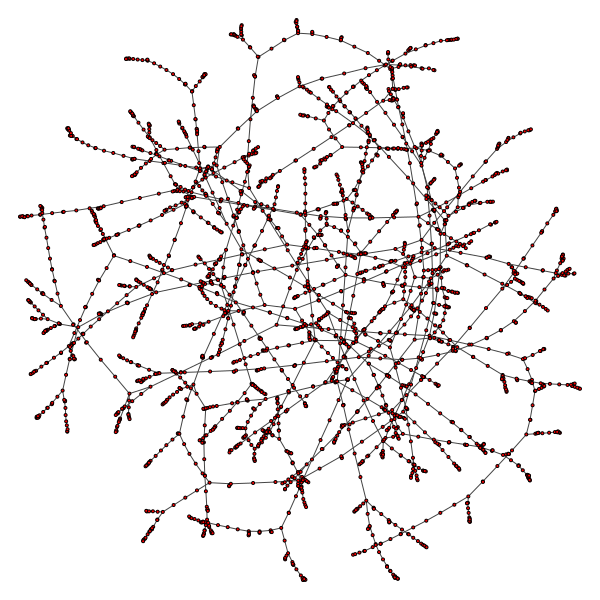

In [ ]:
#Creating the minimum spanning tree
minimum_spanning_tree = gcc.spanning_tree(weights = gcc.es["weight"])
visual_style = {}
visual_style["vertex_size"] = 3
#Plotting the minimum spanning tree
ig.plot(minimum_spanning_tree,**visual_style)

In [ ]:
#Gathering the location data
location_data = {}
with open('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles_censustracts.json', 'r') as f:
    cur_data = json.loads(f.readline())
    for feature in cur_data['features']:
        coordinates = np.array(feature['geometry']['coordinates'][0][0])
        location_data[feature['properties']['MOVEMENT_ID']] = {'address': feature['properties']['DISPLAY_NAME'],
                                                          'mean_coords': np.mean(coordinates.reshape(-1,2), axis=0)}

In [ ]:
#Finding the edges of the minimum spanning tree
minimum_spanning_tree_edges = minimum_spanning_tree.es()
print("The street addresses near the two endpoints (the centroid locations) of a few edges are:")
#Finding the coordinates
for e in minimum_spanning_tree_edges[:10]:
    x, y = minimum_spanning_tree.vs(e.tuple[0])[0]['name'], minimum_spanning_tree.vs(e.tuple[1])[0]['name']
    print(location_data[str(x)]['address'],location_data[str(x)]['mean_coords'],
          location_data[str(y)]['address'],location_data[str(y)]['mean_coords'])

The street addresses near the two endpoints (the centroid locations) of a few edges are:
Census Tract 554001 [-118.133298   33.904119] Census Tract 554002 [-118.141448   33.896526]
Census Tract 461700 [-118.159325   34.153604] Census Tract 460800 [-118.172425   34.180286]
Census Tract 302201 [-118.251349   34.146334] Census Tract 302202 [-118.248811   34.142665]
Census Tract 407101 [-117.967696   34.04101 ] Census Tract 407002 [-117.980572   34.051745]
Census Tract 433401 [-118.043316   34.058606] Census Tract 433402 [-118.038157   34.056957]
Census Tract 543603 [-118.28871    33.803659] Census Tract 294410 [-118.289861   33.797764]
Census Tract 482001 [-118.165951   34.062293] Census Tract 530700 [-118.176633   34.062274]
Census Tract 460800 [-118.172425   34.180286] Census Tract 463800 [-118.167761   34.141469]
Census Tract 269100 [-118.398461   34.057095] Census Tract 217001 [-118.385502   34.04886 ]
Census Tract 011000 [-117.950433   33.881015] Census Tract 001901 [-117.965225   33

QUESTION 10: Build a minimum spanning tree (MST) of graph G. Report the street addresses
near the two endpoints (the centroid locations) of a few edges. Are the results intuitive?
> The street addresses are below:

> ID 1:\
Street Address (a): 9421, Rosecrans Avenue, Bellower, California, 90706, United States of America\
Street Address (b): 9020, Somerset Boulevard, Bellower, Los Angeles County, California, United States of America

> ID 2:\
Street Address (a): 500, Prospect Boulevard, Pasadena, California, 91103, United States of America\
Street Address (b): Brookside Golf Club, Arrovo Woods, Pasadena, CA 91109, United States of America

> ID 3:\
Street Address (a): First United Methodist Church of Glendale, 134 North Kenwood Street, Glendale, CA 91206, United States of America\
Street Address (b): East Colorado Street, Glendale, CA 91205, United States of America

> ID 4:\
Street Address (a): 9421, 619 North Sunset Avenue, La Puente, CA 91744, United States of America\
Street Address (b): 652 Puente Avenue, El Monte, CA 91746, United States of America

> ID 5:\
Street Address (a): 10468 Fern Street, South El Monte, CA 91733, United States of America\
Street Address (b): 2433 Continental Avenue, El Monte, CA 91733, United States of America

> ID 6:\
Street Address (a): Harbor Freeway, West Carson, CA 90710, United States of America\
Street Address (b): 828 Lomita Boulevard, West Carson, CA 90710, United States of America

> ID 7:\
Street Address (a): I-10 Metro ExpressLanes, Los Angeles, CA 90032, United States of America\
Street Address (b): 4225 Drucker Street, East Los Angeles, CA 90032, United States of America

> ID 8:\
Street Address (a): Brookside Golf Club, Arrovo Woods, Pasadena, CA 91109, United States of America\
Street Address (b): Lower Arroyo Park, 415 Arroyo Boulevard, Pasadena, CA 91105, United States of America

> ID 9:\
Street Address (a): 475 Smithwood Drive, Beverly Hills, CA 90212, United States of America\
Street Address (b): Robertson & Airdrome, Robertson Boulevard, Los Angeles, CA 90035-4232, United States of America

> ID 10:\
Street Address (a): 1382 West Valley View Drive, Fullerton, CA 92833, United States of America\
Street Address (b): 2069 West Walnut Avenue, Fullerton, CA 92833, United States of America



> We can see that the street addresses of the endpoints are very close to each other. This is intuitive because the Minimum Spanning Tree (MST) aims to connect all addresses with the lowest cumulative mean travel time, or the lowest weight of edges. A straightforward way to achieve this is by connecting nodes that are close to each other, as the mean travel time between nearby nodes will also be smaller. Thus, Prim’s algorithm selects edges with the smallest weights (mean travel times), ultimately connecting nodes with small pairwise distances. In fact, we observed that the average pairwise distance between the endpoints is around 0.7 miles.

### QUESTION 11

In [ ]:
triangles = []
#Sampling random 1000 triangles
while len(triangles)<1000:
    points = np.random.randint(1,high=len(gcc.vs),size=3)
    try:
        #Getting the edges of the triangle
        e1, e2, e3 = gcc.get_eid(points[0],points[1]), gcc.get_eid(points[1],points[2]), gcc.get_eid(points[2],points[0])
        weights = [gcc.es['weight'][e1],gcc.es['weight'][e2],gcc.es['weight'][e3]]
        triangles.append(weights)
    except: continue

counter = 0
for i in triangles:
    w1, w2, w3 = i[0], i[1], i[2]
    #Checking if it is a valid traingle
    if w1+w2>w3 and w1+w3>w2 and w3+w2>w1:
        counter+=1
print("The percentage of triangles in the graph that satify the triangle inequality are : ", 100*counter/len(triangles))

The percentage of triangles in the graph that satify the triangle inequality are :  91.5


QUESTION 11: Determine what percentage of triangles in the graph (sets of 3 points on the
map) satisfy the triangle inequality. You do not need to inspect all triangles, you can just estimate
by random sampling of 1000 triangles.

> The triangle inequality states that the sum of any two sides of a triangle must always be greater than the third side:\
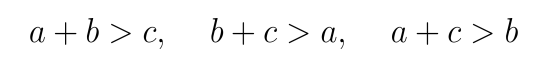\
In the case of our graph, it means the mean travel time between two addresses will always be smaller than the mean travel time between those addresses via a third address.
After randomly sampling 1000 triangles (3 nodes each), we found out that 91.5% of the triangles satisfy the triangle inequality.


### QUESTION 12

In [ ]:
arr = gd
#Swapping the values
for i in range(0,len(arr)):
    if(arr[i][0]>arr[i][1]):
        t = arr[i][0]
        arr[i][0] = arr[i][1]
        arr[i][1] = t
newdf = pd.DataFrame(arr)
arr1 = newdf.groupby([0,1]).mean().reset_index()
arr1 = arr1.rename(columns={0: "source", 1: "sink", 2: "weight"})

g = nx.from_pandas_edgelist(arr1, 'source','sink', ['weight'])
#Creating a subgraph
gcc = g.subgraph(max(nx.connected_components(g), key=len))
minimum_spanning_tree = nx.minimum_spanning_tree(gcc)
mg = nx.MultiGraph()
minimum_spanning_tree_cost = 0
#Finding the cost of the edges
for i in minimum_spanning_tree.edges:
    w = minimum_spanning_tree.edges[i[0],i[1]]['weight']
    minimum_spanning_tree_cost += w
    mg.add_edge(i[0],i[1],weight=w)
    mg.add_edge(i[0],i[1],weight=w)


vertices, count = [], 0
#Counting the vertices
for i in mg.nodes:
    vertices.append(i)
    count += 1
    if count>60:
        break

costs, cur_paths = [], []
#Finding the costs
for vertex in vertices:
    print("Vertex",vertex)
    tour = [u for u,v in nx.eulerian_circuit(mg,source=vertex)]
    cur_path, visited_nodes = [], set()
    for i in tour:
        if i not in visited_nodes:
            cur_path.append(i)
            visited_nodes.add(i)
    cur_path.append(cur_path[0])
    cur_paths.append(cur_path)

    approx_cost = 0
    for i in range(len(cur_path)-1):
        s,t = cur_path[i], cur_path[i+1]
        w = 0
        if minimum_spanning_tree.has_edge(s,t):
            w = minimum_spanning_tree.edges[s,t]['weight']
        else:
            w = nx.dijkstra_path_length(gcc,s,t)
        approx_cost += w
    costs.append(approx_cost)

#Finding the mimimum approximate cost
min_approx_cost = min(costs)
trajectory = cur_paths[np.argmin(costs)]

Vertex 1.0
Vertex 14.0
Vertex 3.0
Vertex 2.0
Vertex 10.0
Vertex 4.0
Vertex 13.0
Vertex 5.0
Vertex 9.0
Vertex 6.0
Vertex 1676.0
Vertex 2015.0
Vertex 7.0
Vertex 8.0
Vertex 11.0
Vertex 12.0
Vertex 18.0
Vertex 22.0
Vertex 15.0
Vertex 1936.0
Vertex 1757.0
Vertex 16.0
Vertex 17.0
Vertex 19.0
Vertex 1758.0
Vertex 1756.0
Vertex 20.0
Vertex 21.0
Vertex 1760.0
Vertex 23.0
Vertex 29.0
Vertex 24.0
Vertex 1972.0
Vertex 25.0
Vertex 2279.0
Vertex 26.0
Vertex 27.0
Vertex 28.0
Vertex 36.0
Vertex 1731.0
Vertex 30.0
Vertex 32.0
Vertex 31.0
Vertex 33.0
Vertex 2258.0
Vertex 1738.0
Vertex 34.0
Vertex 37.0
Vertex 35.0
Vertex 2259.0
Vertex 2019.0
Vertex 52.0
Vertex 51.0
Vertex 53.0
Vertex 58.0
Vertex 311.0
Vertex 76.0
Vertex 59.0
Vertex 60.0
Vertex 2194.0
Vertex 62.0


In [ ]:
print('Minimum Spanning Tree Cost:',minimum_spanning_tree_cost)
print('Approximate Cost:',min_approx_cost)
print('Upper bound of the approximate algorithm is: ',min_approx_cost/minimum_spanning_tree_cost)

Minimum Spanning Tree Cost: 269084.54500000016
Approximate Cost: 421489.3149999998
Upper bound of the approximate algorithm is:  1.5663824728395292


QUESTION 12: Find an upper bound on the empirical performance of the approximate algorithm:

> The Traveling Salesman Problem (TSP) involves an undirected weighted graph where the nodes represent cities and the edges represent roads or streets. The weights of the edges indicate the distances between cities. The objective is to find the shortest route starting from a city, visiting all other cities exactly once, and returning to the starting city. This route is known as a Hamiltonian cycle, which must satisfy the triangle inequality. Since the TSP is NP-Hard, approximation methods are valuable for reducing computation time. We employ a 1-approximation algorithm for solving the TSP, which involves the following steps:\
- Find the Minimum Spanning Tree (MST).
- Create a multi-graph by replacing each edge of the MST with two directed edges.
- Identify the Euler cycle in the multi-graph to establish the tour sequence. An Euler cycle covers each edge exactly once.
- For each edge in the tour sequence, check its existence in the MST. If an edge does not exist, use Dijkstra’s algorithm to find the shortest path between the corresponding nodes.
- Calculate the approximate TSP cost as the sum of the weights of the edges in the tour sequence, or the shortest path cost if the edge is absent in the MST. - The MST cost provides a lower bound, as the optimal TSP cost (best possible route) is always greater than or equal to the MST cost.\
Actually,Length of the tour returned by the algorithm ≤ Distance covered by Euler cycle ≤ 2 X Weight of minimum spanning tree (Length of Euler tour) ≤ 2 X Weight of minimum tour length ☰ MST cost ≤ Optimal TSP cost ≤ Approximate TSP cost ≤ 2 X MST cost\
Our MST cost was 269084.545000000166\
Approximate TSP cost was 421489.3149999998 (which was less than 2 X MST cost = 538169.09)\
Thus, the value of ρ we obtained was 1.5663824728395292. This satisfies the inequality we obtained above.
We observe that the upper bound of ρ is 2, and the lower bound of ρ is 1.



### QUESTION 13

In [ ]:
data = json.load(open('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles_censustracts.json'))
location_data = []
#Looping through the trajectory path
for i in trajectory:
    for j in range(len(data['features'])):
        if data['features'][j]['properties']['MOVEMENT_ID']==str(int(i)):
            cur_loc = data['features'][j]['geometry']['coordinates'][0]
            #Adding the location data
            if len(cur_loc)==1:
                t = np.asarray(cur_loc[0]).mean(axis=0)
                location_data.append(t)
            elif len(cur_loc)==2:
                t = np.asarray(cur_loc[0]+cur_loc[1]).mean(axis=0)
                location_data.append(t)
            elif i==1932.0:
                t = np.asarray(cur_loc[0]+cur_loc[1]+cur_loc[2]+cur_loc[3]+cur_loc[4]+cur_loc[5]).mean(axis=0)
                location_data.append(t)
            else:
                t = np.asarray(cur_loc).mean(axis=0)
                location_data.append(t)
#Getting the coordinates of location data
x,y = [i[0] for i in location_data], [i[1] for i in location_data]
#Use these to export map at https://www.openstreetmap.org/
BBox = ((-118.75,   -117.75,
         33.7, 34.4))

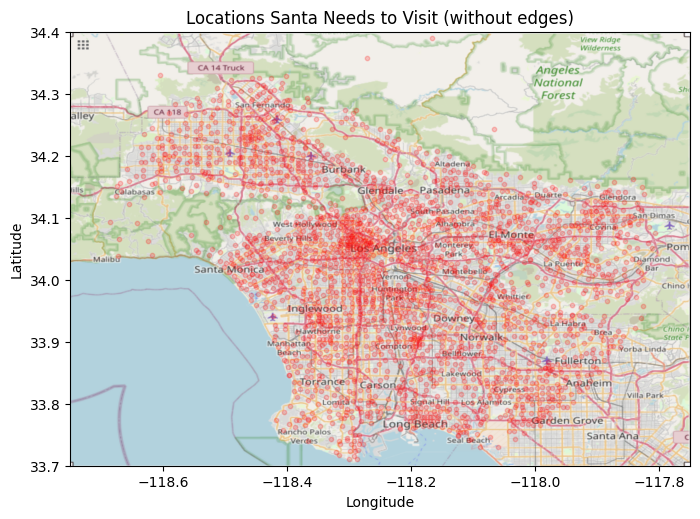

In [ ]:
#Getting the map of LA
la_map = plt.imread('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/LA_Map.png')
fig, ax = plt.subplots(figsize = (8,7))
ax.scatter(x, y, zorder=1, alpha= 0.2, c='r', s=10)
ax.set_title('Locations Santa Needs to Visit (without edges)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
#Setting the x and y values
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(la_map, zorder=0, extent = BBox, aspect= 'equal')
plt.show()

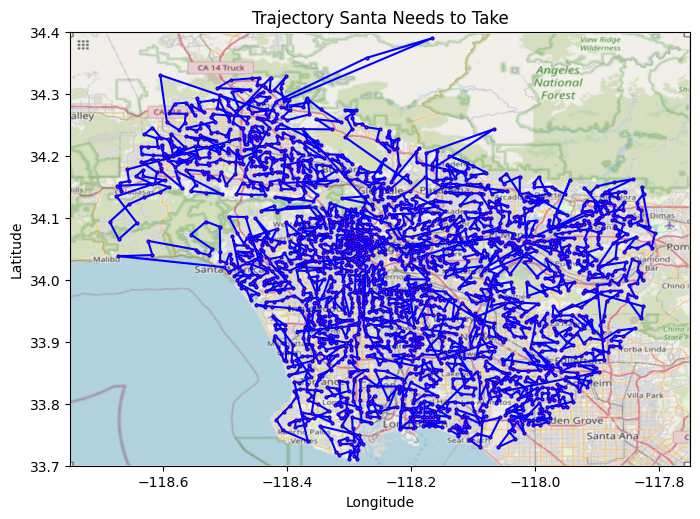

In [ ]:
#Getting the map of LA
la_map = plt.imread('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/LA_Map.png')
fig, ax = plt.subplots(figsize = (8,7))
#Plotting the trajectory santa has to travel
ax.plot(x,y,color='blue',marker='o',markersize=2,markerfacecolor='red')
ax.set_title('Trajectory Santa Needs to Take')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
#Setting the x and y values
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(la_map, zorder=0, extent = BBox, aspect= 'equal')
plt.show()

In [ ]:
#Printing the points Santa has to travel
for i in range(10):
    print('(',x[i],',',y[i],')')

( -118.12911933333332 , 34.08759475 )
( -118.13138209090911 , 34.09626386363636 )
( -118.13785063157897 , 34.09645121052631 )
( -118.13224544444446 , 34.10349303174603 )
( -118.14492316666666 , 34.098681500000005 )
( -118.15023891071432 , 34.09595766071429 )
( -118.15266638571427 , 34.09029572857144 )
( -118.15075123999998 , 34.083419626666675 )
( -118.15280849999998 , 34.098628 )
( -118.15508200990094 , 34.10732695049504 )


QUESTION 13: Plot the trajectory that Santa has to travel!

> Refer to the plots above. The results are logically consistent. Most edges do not overlap, but some do because the graph is not fully connected. This necessitates using Dijkstra’s shortest path algorithm in some cases, which does not adhere strictly to the Eulerian circuit's rule that an edge can only be traversed once. Consequently, some edges overlap, requiring Santa to backtrack to other nodes. Additionally, since the TSP does not incorporate actual road information, some edges cross mountains, oceans, or buildings without any real roads, as seen in the figures above.
We can also see that the TSP algorithm selects the closest addresses (or those that minimize the overall mean travel time) for each traversal, with no addresses being visited more than once. We also calculated that the average distance between successive points in the figure above is approximately 0.6 miles.


### QUESTION 14

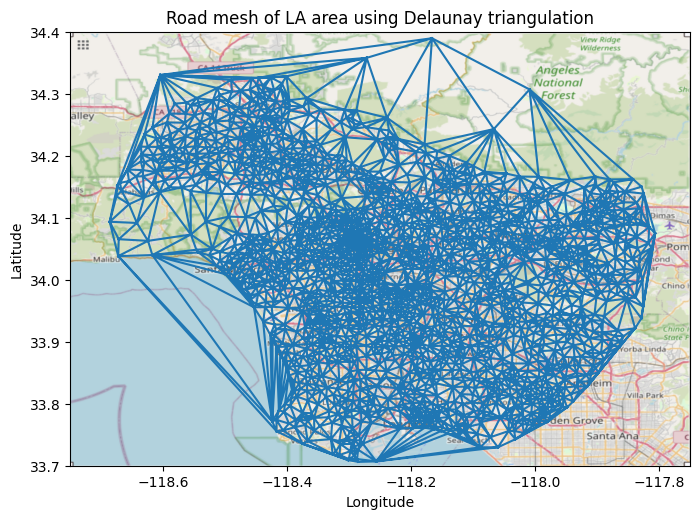

In [ ]:
latitude_longitude_list = {}

#Creating the latitude and longitude list
with open('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles_censustracts.json', 'r') as f:
    cur_data = json.loads(f.readline())
    features = cur_data['features']
    for feature in features:
        latitude = 0.0
        longitude = 0.0
        if feature['geometry']['type']=='Polygon':
            coordinates = np.array(feature['geometry']['coordinates'][0])
            for coordinate in coordinates:
                latitude += coordinate[1]
                longitude += coordinate[0]
        if feature['geometry']['type']=='MultiPolygon':
            coordinates = np.array(feature['geometry']['coordinates'][0][0])
            for coordinate in coordinates:
                latitude += coordinate[1]
                longitude += coordinate[0]
        latitude /= len(coordinates)
        longitude /= len(coordinates)

        latitude_longitude_list[feature['properties']['MOVEMENT_ID']] = (feature['properties']['DISPLAY_NAME'], latitude, longitude)

f.close()

lat=[]
lon=[]
#Getting a tuple of the latitude and longitude
for i in range(1,len(latitude_longitude_list)+1):
    lat.append(latitude_longitude_list[str(i)][1])
    lon.append(latitude_longitude_list[str(i)][2])
lat_lon = tuple(zip(lat, lon))
delaunay_out = Delaunay(lat_lon)

BBox = ((-118.75,   -117.75,
         33.7, 34.4))
#Reading the map of LA stored as a PNG in Drive
la_map = plt.imread('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/LA_Map.png')

#Plotting the mesh
fig, ax = plt.subplots(figsize = (8,7))
plt.triplot(lon, lat, delaunay_out.simplices)
ax.set_title('Road mesh of LA area using Delaunay triangulation')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
#Setting the limits
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(la_map, zorder=0, extent = BBox, aspect= 'equal')
plt.show()

In [ ]:
graph_delaunay=ig.Graph()
#Adding all the vertices
graph_delaunay.add_vertices(len(delaunay_out.points))
remove_duplicates=set()
#Removing all the duplicates
for i in range(len(delaunay_out.simplices)):
    a=((delaunay_out.simplices[i][0], delaunay_out.simplices[i][1]))
    b=((delaunay_out.simplices[i][0], delaunay_out.simplices[i][2]))
    c=((delaunay_out.simplices[i][1], delaunay_out.simplices[i][2]))
    list(a).sort()
    list(b).sort()
    list(c).sort()
    if not a in remove_duplicates:
        remove_duplicates.add(a)
        graph_delaunay.add_edges([a])
    if not b in remove_duplicates:
        remove_duplicates.add(b)
        graph_delaunay.add_edges([b])
    if not c in remove_duplicates:
        remove_duplicates.add(c)
        graph_delaunay.add_edges([c])

In [ ]:
#Plotting the graph
visual_style = {}
visual_style["vertex_size"] = 3
ig.plot(graph_delaunay,**visual_style)

QUESTION 14: Plot the road mesh that you obtain and explain the result. Create a graph G∆
whose nodes are different locations and its edges are produced by triangulation.

> Delaunay Triangulation (DT) is an algorithm for a given set of discrete points that ensures no point lies inside the circumcircle of any triangle in the triangulation. Essentially, DT aims to maximize the minimum angle of all the angles in the triangles, thus avoiding very narrow, or "sliver," triangles. This property is useful for deriving realistic and practical road structures from a set of locations, as real-world road networks tend to follow geometric patterns similar to those produced by DT.\
Refer to the figures above.\
We observe that the triangulation algorithm has successfully extracted most of the road structures in Los Angeles, especially in the downtown area. However, it also shows roads extending over oceans and mountains, which do not exist in reality. This occurs due to the nature of the Delaunay Triangulation (DT) algorithm, which aims to avoid creating very narrow, or "sliver," triangles by ensuring no point in the set lies within the circumcircle of any triangle. In other words, the DT algorithm tries to fit each triangle inside a circumcircle. This is evident in the figure above, where the nodes represent locations and the edges are generated through triangulation. Most of the resulting polygons do not have extremely small acute angles.


### QUESTION 15

QUESTION 15: Using simple math, calculate the traffic flow for each road in terms of cars/hour.
Report your derivation.
Hint: Consider the following assumptions:
* Each degree of latitude and longitude ≈ 69 miles
* Car length ≈ 5 m = 0.003 mile
* Cars maintain a safety distance of 2 seconds to the next car
* Each road has 2 lanes in each direction

Assuming no traffic jam, consider the calculated traffic flow as the max capacity of each road.

> The derivation is below:\
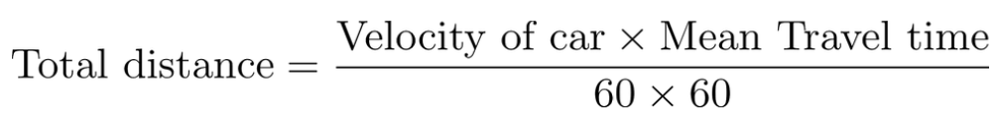\
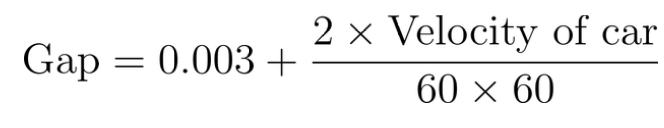\
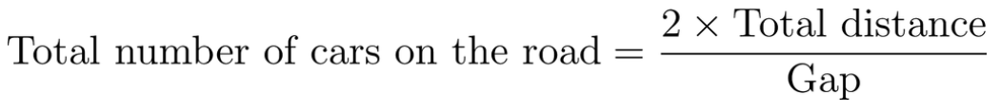\
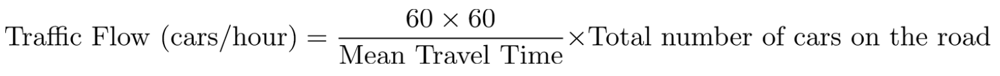\
Simplifying the derivation, we get:\
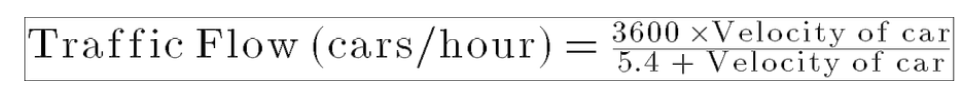\
The unit of velocity is in miles per hour. From Pythagoras Theorem, the velocity of car between two coordinates is given as:\
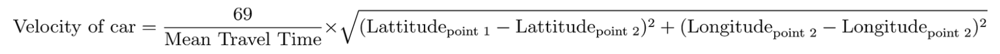


### QUESTION 16

In [ ]:
#Coordinates of malibu beach and long beach
malibu= [34.026, -118.78]
long_beach =  [33.77, -118.18]
vcar=(69*np.sqrt((malibu[0]-long_beach[0])**2+(malibu[1]-long_beach[1])**2))/1.05
max_car_num=(3600*vcar)/(5.4 + vcar)

min_long_beach=np.inf
min_malibu=np.inf
long_beach_node=0
malibu_node=0
#Find which is closest
for i in range(1,len(lat_lon)):
    long_beach_closest=np.sqrt(((lat_lon[i][0])-long_beach[0])**2+((lat_lon[i][1])-long_beach[1])**2)
    malibu_closest=np.sqrt((malibu[0]-lat_lon[i][0])**2+(malibu[1]-lat_lon[i][1])**2)
    if long_beach_closest<min_long_beach:
        min_long_beach=long_beach_closest
        long_beach_node=i
    if malibu_closest<min_malibu:
        min_malibu=malibu_closest
        malibu_node=i

print('The number of edge-disjoint paths between the two spots are: ',graph_delaunay.adhesion(long_beach_node,malibu_node)-1)
print('The degree distribution of nodes (Malibu, Long Beach) is: ', graph_delaunay.degree(malibu_node,mode='out')-1,graph_delaunay.degree(long_beach_node,mode='in')-1)

The number of edge-disjoint paths between the two spots are:  6
The degree distribution of nodes (Malibu, Long Beach) is:  6 8


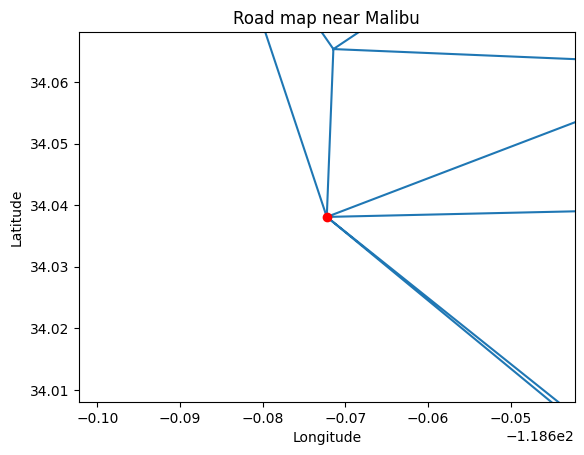

In [ ]:
#Plotting the road map near Malibu
plt.triplot(lon, lat, delaunay_out.simplices)
plt.ylim(lat_lon[malibu_node][0]-0.03,lat_lon[malibu_node][0]+0.03)
plt.xlim(lat_lon[malibu_node][1]-0.03,lat_lon[malibu_node][1]+0.03)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Road map near Malibu')
plt.plot(lon[malibu_node], lat[malibu_node],'o',color='red')
plt.show()

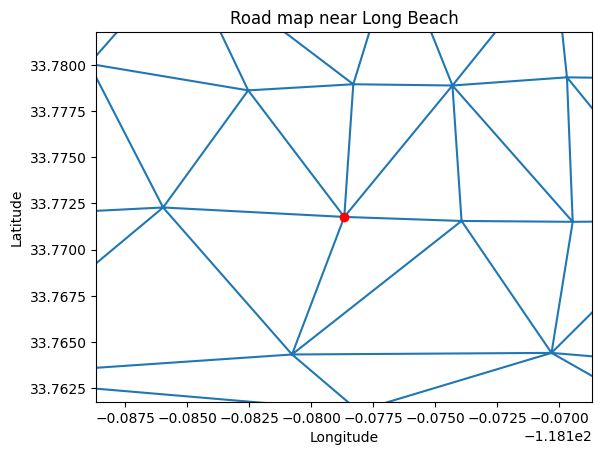

In [ ]:
#Plotting the road map near long beach
plt.triplot(lon, lat, delaunay_out.simplices)
plt.ylim(lat_lon[long_beach_node][0]-0.01,lat_lon[long_beach_node][0]+0.01)
plt.xlim(lat_lon[long_beach_node][1]-0.01,lat_lon[long_beach_node][1]+0.01)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Road map near Long Beach')
plt.plot(lon[long_beach_node], lat[long_beach_node],'o',color='red')
plt.show()

QUESTION 16: Calculate the maximum number of cars that can commute per hour from Malibu
to Long Beach. Also calculate the number of edge-disjoint paths between the two spots. Does the
number of edge-disjoint paths match what you see on your road map?

> The maximum number of cars from Malibu to Long Beach: 3285\
Refer to the plots above.\
The plots in the figure above show that both Malibu and Long Beach have 6 outgoing and incoming edges, respectively. Additionally, we can see that the degree of each node is the same. For two nodes in a graph, the minimum number of outgoing and incoming edges at each node determines the number of edge-disjoint paths between them. In this case, that number is 6.


### QUESTION 17

In [ ]:
g_del_prune=ig.Graph()
g_del_prune.add_vertices(len(delaunay_out.points))
nodes=g_del_prune.vs()
i=0
#Storing the latitude and longitude
for node in nodes:
    node['latitude']=lat[i]
    node['longitude']=lon[i]
    i+=1

threshold=(19.2/69)

duplicate_remove=set()
edge_cut=set()
for i in range(len(delaunay_out.simplices)):
    a=((delaunay_out.simplices[i][0], delaunay_out.simplices[i][1]))
    b=((delaunay_out.simplices[i][0], delaunay_out.simplices[i][2]))
    c=((delaunay_out.simplices[i][1], delaunay_out.simplices[i][2]))
    list(a).sort()
    list(b).sort()
    list(c).sort()
    #Add all except the duplicates
    if not a in duplicate_remove:
        duplicate_remove.add(a)
        a_dist_check=np.sqrt((nodes[a[0]]['latitude']-nodes[a[1]]['latitude'])**2+(nodes[a[0]]['longitude']-nodes[a[1]]['longitude'])**2)
        if a_dist_check<threshold:
            g_del_prune.add_edges([a])
        else:
            edge_cut.add(a)
    if not b in duplicate_remove:
        duplicate_remove.add(b)
        b_dist_check=np.sqrt((nodes[b[0]]['latitude']-nodes[b[1]]['latitude'])**2+(nodes[b[0]]['longitude']-nodes[b[1]]['longitude'])**2)
        if b_dist_check<threshold:
            g_del_prune.add_edges([b])
        else:
            edge_cut.add(b)
    if not c in duplicate_remove:
        duplicate_remove.add(c)
        c_dist_check=np.sqrt((nodes[c[0]]['latitude']-nodes[c[1]]['latitude'])**2+(nodes[c[0]]['longitude']-nodes[c[1]]['longitude'])**2)
        if c_dist_check<threshold:
            g_del_prune.add_edges([c])
        else:
            edge_cut.add(c)

edge_cut_list=list(edge_cut)
simplices_list=[]
#Get the simplices list
for simplex in delaunay_out.simplices:
    for edge in edge_cut_list:
        if edge[0] in simplex and edge[1] in simplex:
            simplices_list.append(list(simplex))

new_delaunay_out_desimplices = [i for i in delaunay_out.simplices if i not in np.array(simplices_list)]

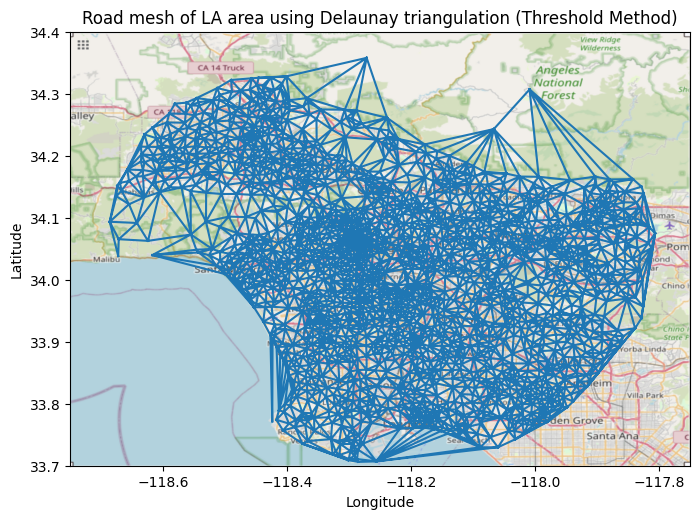

In [ ]:
BBox = ((-118.75,   -117.75,
         33.7, 34.4))
#Read the LA Map from drive
la_map = plt.imread('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/LA_Map.png')

#Plot the road mesh of LA using Delaunay triangulation
fig, ax = plt.subplots(figsize = (8,7))
plt.triplot(lon, lat, new_delaunay_out_desimplices)
ax.set_title('Road mesh of LA area using Delaunay triangulation (Threshold Method)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.imshow(la_map, zorder=0, extent = BBox, aspect= 'equal')
plt.show()

In [ ]:
#Plotting
visual_style = {}
visual_style["vertex_size"] = 3
ig.plot(g_del_prune,**visual_style)

QUESTION 17: Plot G˜∆ on actual coordinates. Do you think the thresholding method worked?

> We apply a threshold to the travel time of roads. Theoretically, this thresholding method removes long edges that the DT algorithm might produce to fit triangles within the circumcircle. The mean travel time for these edges would be higher than for other edges, as they span several nodes at smaller distances. We improve the threshold by incorporating distance information, so that points which are close but have a large travel time are excluded. This ensures that we do not eliminate roads between points that are actually far apart. By incorporating distance information, we effectively set a speed threshold, which we establish at 19.2 miles per hour.\
Refer to the figures above.\
From the figure above, we can observe that the long, non-existent routes over the ocean and the routes over the Topanga mountain ranges have disappeared, indicating the effectiveness of the thresholding method. The road mesh network now more closely resembles the actual Los Angeles road map, with most roads staying within the coastline and avoiding beaches and mountains. Additionally, the figure above shows fewer long edges among neighboring nodes compared to the figure from Question 14, demonstrating that the speed threshold successfully removed only those long edges that connected neighboring nodes.




### QUESTION 18

In [ ]:
#Getting the number of edge disjoint paths
print('The number of edge-disjoint paths between the two spots are: ',g_del_prune.adhesion(long_beach_node,malibu_node)-1)
print('The degree distribution of nodes (Malibu, Long Beach) is: ', g_del_prune.degree(malibu_node,mode='out')-1,g_del_prune.degree(long_beach_node,mode='in')-1)

The number of edge-disjoint paths between the two spots are:  3
The degree distribution of nodes (Malibu, Long Beach) is:  3 8


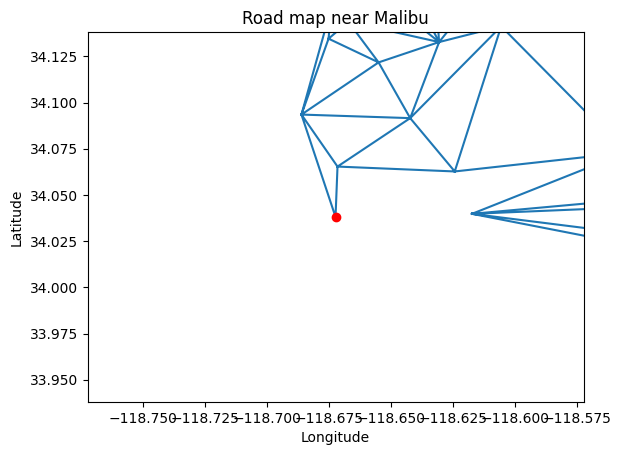

In [ ]:
#Plotting the road map near Malibu
plt.triplot(lon, lat, new_delaunay_out_desimplices)
plt.ylim(lat_lon[malibu_node][0]-0.1,lat_lon[malibu_node][0]+0.1)
plt.xlim(lat_lon[malibu_node][1]-0.1,lat_lon[malibu_node][1]+0.1)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Road map near Malibu')
plt.plot(lon[malibu_node], lat[malibu_node],'o',color='red')
plt.show()

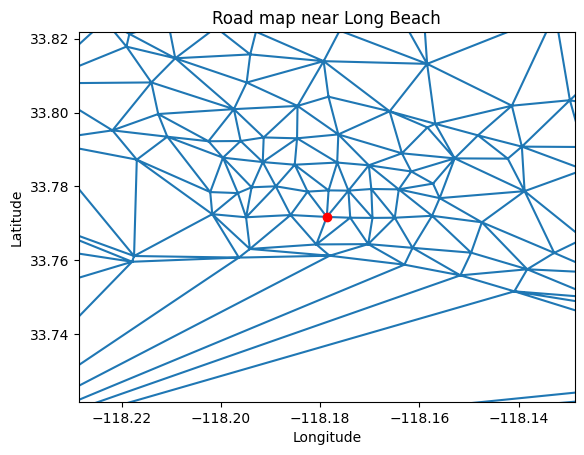

In [ ]:
#Plotting the road map near Long Beach
plt.triplot(lon, lat, new_delaunay_out_desimplices)
plt.ylim(lat_lon[long_beach_node][0]-0.05,lat_lon[long_beach_node][0]+0.05)
plt.xlim(lat_lon[long_beach_node][1]-0.05,lat_lon[long_beach_node][1]+0.05)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Road map near Long Beach')
plt.plot(lon[long_beach_node], lat[long_beach_node],'o',color='red')
plt.show()

QUESTION 18: Now, repeat question 13 for G˜∆ and report the results. Do you see any changes?
Why?

> The maximum number of cars from Malibu to Long Beach: 3300\
After removing the non-existent paths, the number of disjoint paths have now decreased from 6 to 3.\
Refer to the figures above.\
From the figure above, we see that there has not been any significant change to the road map near Long Beach. However, several non-existent paths to Malibu have been pruned. For two nodes in a graph, the minimum number of outgoing and incoming edges at each node determines the number of edge-disjoint paths, which in this case is 3. Due to the removal of some paths to Malibu, the number of possible edge-disjoint paths between Malibu and Long Beach has decreased.\
However, the maximum flow remains at 13,095 cars per hour. This is because there are still numerous paths available for cars to travel from Malibu to Long Beach. The total capacity of all roads connecting Malibu to Long Beach still exceeds 13,095 cars. Additionally, the way the max-flow algorithm functions contributes to this outcome. Maximum flow is calculated by summing the flow across the minimum cuts (edges with the lowest weights). It is unlikely that the non-existent roads had the lowest weights, and therefore they did not impact the maximum flow. As a result, there is no significant difference in the maximum flow.



### QUESTION 19

In [ ]:
# get location data with mean centroid coordinates
display_names = dict()
coordinates = dict()
with open('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles_censustracts.json', 'r') as f:
    census_tracts = json.loads(f.readline())
    for area in census_tracts['features']:
        id = int(area['properties']['MOVEMENT_ID'])
        display_name = area['properties']['DISPLAY_NAME']
        display_names[id] = display_name
        a = area['geometry']['coordinates'][0]
        coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

g = ig.Graph(directed=False)
g.add_vertices(len(display_names))
g.vs['display_name'] = list(display_names.values())  # index = id - 1
g.vs['coordinates'] = list(coordinates.values())

month_filter = {12}  # for monthly aggregate data of 4th quarter, we can filter data based off of only December

edges = []
weights = []
with open('gdrive/My Drive/Spring Quarter 2024/EC232/Project 4/los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv') as f:
    f.readline()  # skip the first line

    while True:
        line = f.readline()
        if line == '':
            break  # end of file

        vals = line.strip().split(',')

        # read edge info
        src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])

        # if data is not relevant, skip it
        if month not in month_filter:
            continue

        edges.append((src - 1, dest - 1))
        weights.append(dist)

g.add_edges(edges)
g.es['weight'] = weights
del edges, weights

# keep only the giant connected component
components = g.components()
gcc = max(components, key=len)  # idx of vertex, not ids
vs_to_delete = [i for i in range(len(g.vs)) if i not in gcc]
g.delete_vertices(vs_to_delete)

# remove duplicate edges
g = g.simplify(combine_edges=dict(weight='mean'))  # combine duplicate edges


In [ ]:
tri = Delaunay(np.array([i["coordinates"] for i in g.vs]))

In [ ]:
# distance threshold in miles
dist_thr = 18

edge_to_delete = []
for i in range(len(tri.simplices)):
    pt1 = tri.points[tri.simplices[i][0]]
    pt2 = tri.points[tri.simplices[i][1]]
    pt3 = tri.points[tri.simplices[i][2]]

    d12 = np.sqrt((pt1[0]-pt2[0])**2+(pt1[1]-pt2[1])**2)*69
    d23 = np.sqrt((pt2[0]-pt3[0])**2+(pt2[1]-pt3[1])**2)*69
    d13 = np.sqrt((pt1[0]-pt3[0])**2+(pt1[1]-pt3[1])**2)*69

    if d12 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][1]))
    if d23 > dist_thr:
        edge_to_delete.append((tri.simplices[i][1], tri.simplices[i][2]))
    if d13 > dist_thr:
        edge_to_delete.append((tri.simplices[i][0], tri.simplices[i][2]))

simplices_to_cut = []
for simplex in tri.simplices:
    for edge in edge_to_delete:
        if edge[0] in simplex and edge[1] in simplex:
            simplices_to_cut.append(list(simplex))

tri_simplices_prune = np.array([i for i in tri.simplices if i not in np.array(simplices_to_cut)])

In [ ]:
edges_to_induce_prune = []

for i in range(tri_simplices_prune.shape[0]):
    for col1, col2 in ((0, 1), (1, 2), (0, 2)):
        # add the edges to edges_to_induce_prune
        try:
            edge = tuple(sorted((tri_simplices_prune[i][col1], tri_simplices_prune[i][col2])))
            e_id = g.get_eid(edge[0], edge[1])
            if edge not in edges_to_induce_prune:
                edges_to_induce_prune.append(edge)
        except:
            continue

In [ ]:
tri_g_prune = g.subgraph_edges(edges_to_induce_prune)

In [ ]:
road_map = deepcopy(tri_g_prune)
len(road_map.vs), len(road_map.es)

(2646, 7762)

In [ ]:
edge_ends = np.array([[e.source, e.target] for e in road_map.es])
sources, targets = edge_ends[:, 0], edge_ends[:, 1]
road_map_vs = np.array(road_map.vs['coordinates'])
distances = np.sqrt((road_map_vs[sources][:, 0] - road_map_vs[targets][:, 0])**2 +
                    (road_map_vs[sources][:, 1] - road_map_vs[targets][:, 1])**2)
road_map.es['geo_distance'] = distances
vcount = len(road_map.vs)
max(distances)

0.13271902711268524

In [ ]:
'''
Method 1: use "graph.get_shortest_paths()" function
  Calculates the shortest paths from/to a given node in a graph.
  Return all nodes in the shortest path
'''
# shortest_path_distance = np.zeros((vcount, vcount))
# for i in range(vcount):
#     for j in range(i, vcount):
#         if i == j:
#             shortest_path_distance[i, j] = 0
#         else:
#             #
#             paths_idx = road_map.get_shortest_paths(i, to=j, weights=road_map.es['geo_distance'])[0]
#             dist_sum = np.array(road_map.es['geo_distance'])[paths_idx].sum()
#             shortest_path_distance[i, j] = dist_sum
#             shortest_path_distance[j, i] = dist_sum

'''
Method 2: use "graph.shortest_paths()" function by looping through all pairs
  Calculates shortest path lengths for given vertices in a graph.
  Return the shortest path lengths

  The algorithm used for the calculations is selected automatically:
    a simple BFS is used for unweighted graphs, Dijkstra's algorithm is used
    when all the weights are positive. Otherwise, the Bellman-Ford algorithm
    is used if the number of requested source vertices is larger than 100
    and Johnson's algorithm is used otherwise.
'''
# shortest_path_distance = np.zeros((vcount, vcount))
# for i in range(vcount):
#     for j in range(i, vcount):
#         if i == j:
#             shortest_path_distance[i, j] = 0
#         else:
#             dist_sum = road_map.shortest_paths(source=i, target=j, mode='all',
#                                                weights=road_map.es['geo_distance'])[0][0]
#             shortest_path_distance[i, j] = dist_sum
#             shortest_path_distance[j, i] = dist_sum

'''
Method 3: use "graph.shortest_paths()" function
  with a given list containing the source and targetvertex IDs

  The algorithm used for the calculations is selected automatically:
    a simple BFS is used for unweighted graphs, Dijkstra's algorithm is used
    when all the weights are positive. Otherwise, the Bellman-Ford algorithm
    is used if the number of requested source vertices is larger than 100
    and Johnson's algorithm is used otherwise.
'''
shortest_path_distance = np.array(road_map.shortest_paths(source=np.arange(vcount),
                                                          target=np.arange(vcount),
                                                          weights=road_map.es['geo_distance'],
                                                          mode='all'))

shortest_path_distance.shape

<ipython-input-15-06eda161e37a>:50: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  shortest_path_distance = np.array(road_map.shortest_paths(source=np.arange(vcount),


(2646, 2646)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map.vs['coordinates'][i]
        v2_coor = road_map.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
differences = shortest_path_distance - actual_geo_distances
differences.shape

(2646, 2646)

In [ ]:
k = 20
top_k = np.argsort(differences.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra distance".format(k))
new_static_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_static_edges.append(sort_edge)
    print("- Source, Destination: {}, Extra Distance: {:.5f}".format(sort_edge, differences[row, col]))

# new_static_edges

The top 20 pairs with highest extra distance
- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (382, 2418), Extra Distance: 0.20195
- Source, Destination: (383, 2418), Extra Distance: 0.19896
- Source, Destination: (391, 2418), Extra Distance: 0.19730
- Source, Destination: (1901, 2418), Extra Distance: 0.19669
- Source, Destination: (381, 2418), Extra Distance: 0.19652
- Source, Destination: (2163, 2418), Extra Distance: 0.19515
- Source, Destination: (386, 2418), Extra Distance: 0.19462
- Source, Destination: (390, 2418), Extra Distance: 0.19458
- Source, Destination: (1904, 2418), Extra Distance: 0.19407
- Source, Destination: (45, 2418), Extra Distance: 0.19392
- Source, Destination: (1906, 2418), Extra Distance: 0.19391
- Source, Destination: (2158, 2418), Extra Distance: 0.19390
- Source, Destination: (1902, 2418), Extra Distance: 0.19386
- Source, Destination: (392, 2418), Extra Distance: 0.19370
- Source, Destination: (393, 2418), Extra Distanc

In [ ]:
# add the new_static_edges to our graph.

road_map_static = deepcopy(tri_g_prune) #ensure to use deepcopy
for edg in new_static_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end]
    road_map_static.add_edge(start, end, geo_distance=dist)

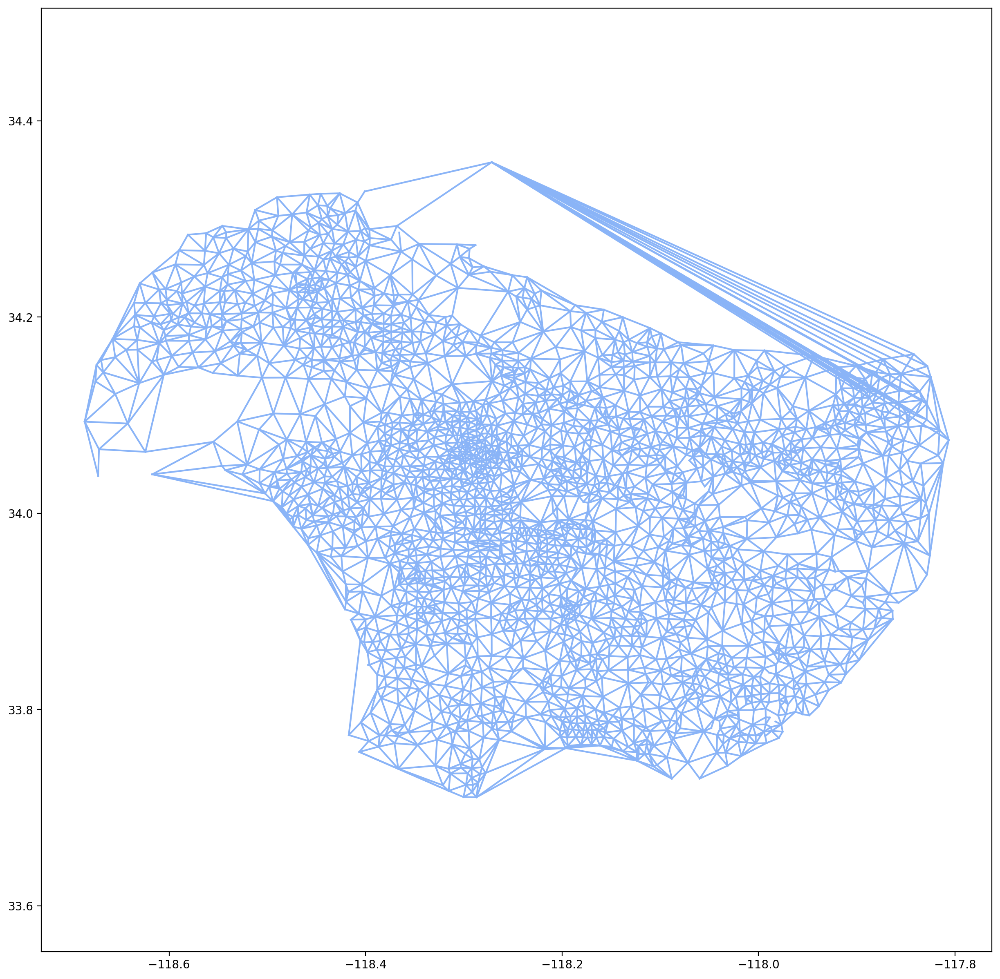

In [ ]:
# plot the roads and highlight our new edges.
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_static.vs[e.source]['coordinates']
    v2 = road_map_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_static_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()


QUESTION 19: Strategy 1 (geo distance, static): Reduce the maximum extra travelling dis- tance. The extra travelling distance between 2 locations is the difference of the shortest traveling distance and the straight line distance. i.e
extra distance(v,s) = distance of shortest path(v,s) - euclidean distance(v,s)

Use the coordinates of v and s to get the euclidean distance between them. Calculate the ex- tra distance between all pairs of points. The top 20 pairs with highest extra distance will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy?

> The resultant graph on actual coordinates is illustrated above and the time complexity of this strategy is around O(E.logV) where V is the number of vertices and E is the total number of edges because the main time-consuming part at here is the Dijkstra's shortest path algorithm, which has a time complexity of O(E.logV). For the Subtraction of receiving the final distance difference, the time complexity is supposed to be O(V2). However, since it's implemented with numpy, which probably is programmed in C with time complexity of O(V) or even faster. Therefore, it is ignorable compared to O(E.logV).
The top 20 pairs with highest extra distance are the following:
- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (382, 2418), Extra Distance: 0.20195
- Source, Destination: (383, 2418), Extra Distance: 0.19896
- Source, Destination: (391, 2418), Extra Distance: 0.19730
- Source, Destination: (1901, 2418), Extra Distance: 0.19669
- Source, Destination: (381, 2418), Extra Distance: 0.19652
- Source, Destination: (2163, 2418), Extra Distance: 0.19515
- Source, Destination: (386, 2418), Extra Distance: 0.19462
- Source, Destination: (390, 2418), Extra Distance: 0.19458
- Source, Destination: (1904, 2418), Extra Distance: 0.19407
- Source, Destination: (45, 2418), Extra Distance: 0.19392
- Source, Destination: (1906, 2418), Extra Distance: 0.19391
- Source, Destination: (2158, 2418), Extra Distance: 0.19390
- Source, Destination: (1902, 2418), Extra Distance: 0.19386
- Source, Destination: (392, 2418), Extra Distance: 0.19370
- Source, Destination: (393, 2418), Extra Distance: 0.19369
- Source, Destination: (2159, 2418), Extra Distance: 0.19362
- Source, Destination: (48, 2418), Extra Distance: 0.19355
- Source, Destination: (2162, 2418), Extra Distance: 0.19349
- Source, Destination: (47, 2418), Extra Distance: 0.19336



### QUESTION 20

In [ ]:
np.random.seed(2022)
frequencies = np.random.randint(1, 1001, (vcount,vcount))
frequencies.shape

(2646, 2646)

In [ ]:
difference_frequency = np.multiply(differences, frequencies)

In [ ]:
k = 20
top_k = np.argsort(difference_frequency.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra distance".format(k))
new_static_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_static_edges.append(sort_edge)
    print("- Source, Destination: {}, Weighted Extra Distance: "\
          "{:.5f}".format(sort_edge, difference_frequency[row, col]))

The top 20 pairs with highest extra distance
- Source, Destination: (47, 2418), Weighted Extra Distance: 192.39530
- Source, Destination: (393, 2418), Weighted Extra Distance: 190.39247
- Source, Destination: (394, 2418), Weighted Extra Distance: 187.01942
- Source, Destination: (452, 2418), Weighted Extra Distance: 184.07887
- Source, Destination: (2171, 2418), Weighted Extra Distance: 183.52048
- Source, Destination: (2173, 2418), Weighted Extra Distance: 182.83703
- Source, Destination: (384, 2418), Weighted Extra Distance: 182.47690
- Source, Destination: (2156, 2418), Weighted Extra Distance: 179.17012
- Source, Destination: (2053, 2418), Weighted Extra Distance: 178.42716
- Source, Destination: (2146, 2418), Weighted Extra Distance: 177.57198
- Source, Destination: (2079, 2418), Weighted Extra Distance: 177.34854
- Source, Destination: (2222, 2418), Weighted Extra Distance: 177.18152
- Source, Destination: (386, 2418), Weighted Extra Distance: 176.91278
- Source, Destination: (21

In [ ]:
# add the new_static_edges to our graph.
road_map_static = deepcopy(road_map) #ensure to use deepcopy
for edg in new_static_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end]
    road_map_static.add_edge(start, end, weight = dist)

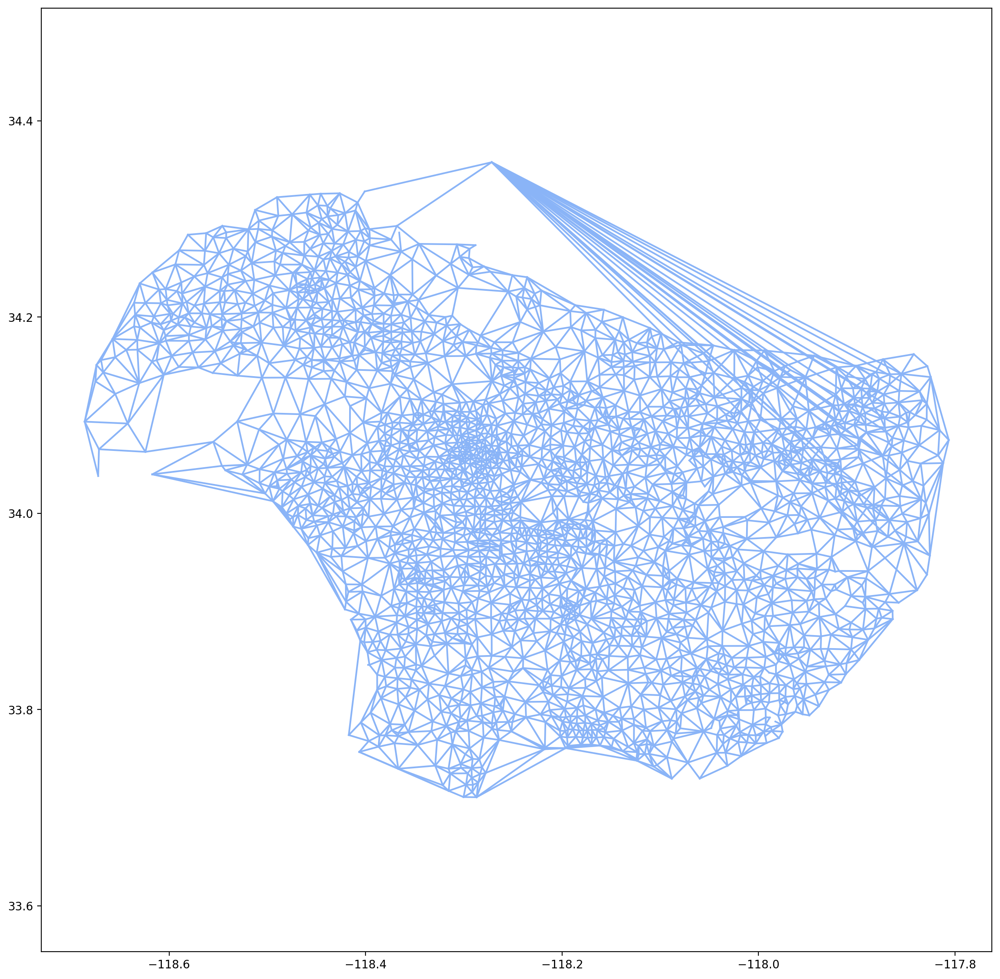

In [ ]:
# plot the roads and highlight our new edges.
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_static.vs[e.source]['coordinates']
    v2 = road_map_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_static_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

QUESTION 20: Strategy 2 (geo distance, static, with frequency): In strategy1, we are using the geographical distance between points to decide which new road to create. However, in the real world, some pairs are more in demand than other pairs. Assume that you know the frequency of travel between every pair. Use the frequency as the weight to multiply the difference. i.e

weighted extra distance(v,s) = extra distance(v,s) * frequency(v,s)

where frequency(v,s) is a random integer between [1,1000]. Use the coordinates of v and s to get the euclidean distance between them. Calculate the weighted extra distance between all pairs of points. The top 20 pairs with highest weighted extra distance will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy?

> The resultant graph on actual coordinates is illustrated above and similar to Q19, the time complexity of Dijkstra's shortest path algorithm is O(E.logV). However, this time, we have to multiply the distance difference matrix with the frequency matrix, which has a time complexity of O(V2). Therefore, the total time complexity is O(E.logV) + O(V2).
The top 20 pairs with highest extra distance are the following:
- Source, Destination: (47, 2418), Weighted Extra Distance: 192.39530
- Source, Destination: (393, 2418), Weighted Extra Distance: 190.39247
- Source, Destination: (394, 2418), Weighted Extra Distance: 187.01942
- Source, Destination: (452, 2418), Weighted Extra Distance: 184.07887
- Source, Destination: (2171, 2418), Weighted Extra Distance: 183.52048
- Source, Destination: (2173, 2418), Weighted Extra Distance: 182.83703
- Source, Destination: (384, 2418), Weighted Extra Distance: 182.47690
- Source, Destination: (2156, 2418), Weighted Extra Distance: 179.17012
- Source, Destination: (2053, 2418), Weighted Extra Distance: 178.42716
- Source, Destination: (2146, 2418), Weighted Extra Distance: 177.57198
- Source, Destination: (2079, 2418), Weighted Extra Distance: 177.34854
- Source, Destination: (2222, 2418), Weighted Extra Distance: 177.18152
- Source, Destination: (386, 2418), Weighted Extra Distance: 176.91278
- Source, Destination: (2155, 2418), Weighted Extra Distance: 175.34277
- Source, Destination: (2191, 2418), Weighted Extra Distance: 175.01971
- Source, Destination: (2226, 2418), Weighted Extra Distance: 174.65783
- Source, Destination: (2418, 2471), Weighted Extra Distance: 173.87486
- Source, Destination: (53, 2418), Weighted Extra Distance: 173.45512
- Source, Destination: (390, 2418), Weighted Extra Distance: 172.78550
- Source, Destination: (1956, 2418), Weighted Extra Distance: 172.23827


### QUESTION 21

In [ ]:
road_map_dynamic = deepcopy(road_map)
budget = 20
new_dynamic_edges = []

print("The top 20 pairs with highest extra distance")
for iter in range(budget):
    # get current graph shortest paths
    cur_shortest_path_distance = road_map_dynamic.shortest_paths(source=np.arange(vcount),
                                                                 target=np.arange(vcount),
                                                                 weights=road_map_dynamic.es['geo_distance'],
                                                                 mode='all')
    cur_shortest_path_distance = np.array(cur_shortest_path_distance)
    # get differences
    cur_diff = cur_shortest_path_distance - actual_geo_distances
    # sort differences and pich the highest
    top_1 = np.argsort(cur_diff.reshape(-1))[-1]
    # get vertices of new edge to build. Build the edge and print its vertices
    row, col = int(top_1//vcount), int(top_1%vcount)
    new_edge = tuple(sorted((row, col)))
    new_dynamic_edges.append(new_edge)
    print("- Source, Destination: {}, Extra Distance: {:.5f}".format(new_edge, cur_diff[row, col]))

    #add the new edge
    new_distance = actual_geo_distances[row, col]
    road_map_dynamic.add_edge(row, col, weight=-1 , geo_distance=new_distance)

The top 20 pairs with highest extra distance


<ipython-input-26-10eb8766bd28>:8: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  cur_shortest_path_distance = road_map_dynamic.shortest_paths(source=np.arange(vcount),


- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (285, 2418), Extra Distance: 0.19004
- Source, Destination: (1956, 2418), Extra Distance: 0.17665
- Source, Destination: (2241, 2418), Extra Distance: 0.16490
- Source, Destination: (1699, 1700), Extra Distance: 0.15982
- Source, Destination: (509, 2418), Extra Distance: 0.14485
- Source, Destination: (1684, 2418), Extra Distance: 0.11692
- Source, Destination: (1700, 2417), Extra Distance: 0.10567
- Source, Destination: (985, 1860), Extra Distance: 0.09794
- Source, Destination: (1699, 1860), Extra Distance: 0.09577
- Source, Destination: (1783, 2411), Extra Distance: 0.08951
- Source, Destination: (989, 1510), Extra Distance: 0.08380
- Source, Destination: (430, 2618), Extra Distance: 0.07732
- Source, Destination: (1860, 2417), Extra Distance: 0.07624
- Source, Destination: (144, 2618), Extra Distance: 0.07009
- Source, Destination: (1700, 1783), Extra Distance: 0.06700
- Source, Destination: (430, 2

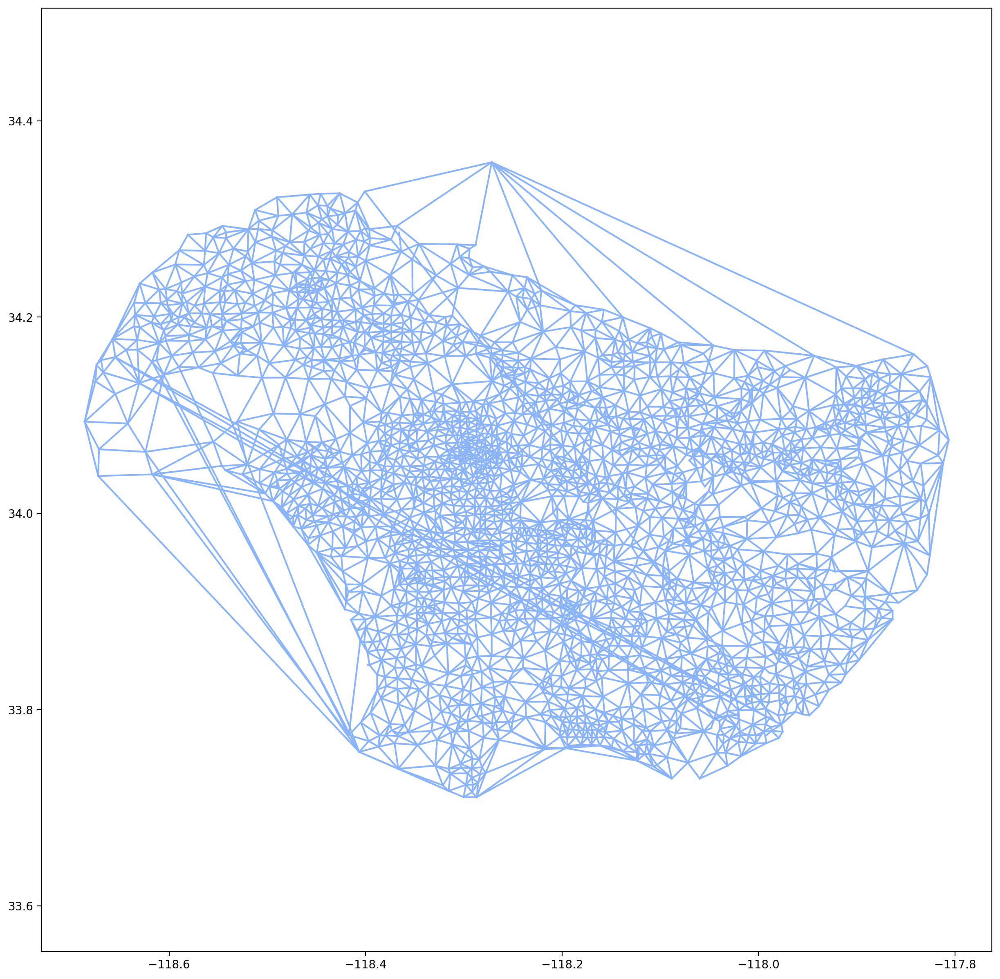

In [ ]:
# plot the roads
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_dynamic.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_dynamic.vs[e.source]['coordinates']
    v2 = road_map_dynamic.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_dynamic_edges:
        print(cur_edge)
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

QUESTION 21: Strategy 3 (geo distance, dynamic): In the above strategy, we are creating all roads at the same time. This time, we will create the roads one by one.
Repeat 20 times:\
i) Compute extra distance between all the pairs in the graph.\
ii) Create a road between the pair with highest extra distance and update the graph.\
iii) Print the source and destination of this new edge.

Report the source and destination of the 20 new edges. plot the final graph on actual coordinates. What is the time complexity of the strategy?

> The final graph on actual coordinates is shown above. The time complexity of this algorithm is around O(N.ElogV), where N is the number of repeats.
The top 20 pairs with highest extra distance are the following:
- Source, Destination: (2140, 2418), Extra Distance: 0.20474
- Source, Destination: (285, 2418), Extra Distance: 0.19004
- Source, Destination: (1956, 2418), Extra Distance: 0.17665
- Source, Destination: (2241, 2418), Extra Distance: 0.16490
- Source, Destination: (1699, 1700), Extra Distance: 0.15982
- Source, Destination: (509, 2418), Extra Distance: 0.14485
- Source, Destination: (1684, 2418), Extra Distance: 0.11692
- Source, Destination: (1700, 2417), Extra Distance: 0.10567
- Source, Destination: (985, 1860), Extra Distance: 0.09794
- Source, Destination: (1699, 1860), Extra Distance: 0.09577
- Source, Destination: (1783, 2411), Extra Distance: 0.08951
- Source, Destination: (989, 1510), Extra Distance: 0.08380
- Source, Destination: (430, 2618), Extra Distance: 0.07732
- Source, Destination: (1860, 2417), Extra Distance: 0.07624
- Source, Destination: (144, 2618), Extra Distance: 0.07009
- Source, Destination: (1700, 1783), Extra Distance: 0.06700
- Source, Destination: (430, 2558), Extra Distance: 0.06657
- Source, Destination: (144, 2558), Extra Distance: 0.06551
- Source, Destination: (2128, 2618), Extra Distance: 0.06456
- Source, Destination: (1005, 1860), Extra Distance: 0.06455


### QUESTION 22

In [ ]:
road_map_time = deepcopy(road_map)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map_time.vs['coordinates'][i]
        v2_coor = road_map_time.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
# get the shortest time
current_shortest_time = road_map_time.shortest_paths(source=np.arange(vcount),
                                                     target=np.arange(vcount),
                                                     weights=road_map_time.es['weight'],
                                                     mode='all')
current_shortest_time = np.array(current_shortest_time) / 60 / 60 # convert unit to [hr]

shortest_paths = road_map_time.shortest_paths(source=np.arange(vcount),
                                              target=np.arange(vcount),
                                              weights=road_map_time.es['geo_distance'],
                                              mode='all')
shortest_paths = np.array(shortest_paths) * 69 # convert unit to [miles]
actual_geo_distances = np.array(actual_geo_distances) * 69 # convert unit to [miles]

current_speed = np.nan_to_num(shortest_paths / current_shortest_time) # unit in [miles/hr]

<ipython-input-30-b551fa8d3c7c>:2: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  current_shortest_time = road_map_time.shortest_paths(source=np.arange(vcount),
<ipython-input-30-b551fa8d3c7c>:8: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  shortest_paths = road_map_time.shortest_paths(source=np.arange(vcount),
<ipython-input-30-b551fa8d3c7c>:15: RuntimeWarning: invalid value encountered in divide
  current_speed = np.nan_to_num(shortest_paths / current_shortest_time) # unit in [miles/hr]


In [ ]:
# compute extra time
time_diffence = current_shortest_time - np.nan_to_num(actual_geo_distances/current_speed)

<ipython-input-31-20ba77f908c1>:2: RuntimeWarning: invalid value encountered in divide
  time_diffence = current_shortest_time - np.nan_to_num(actual_geo_distances/current_speed)


In [ ]:
k = 20
top_k = np.argsort(time_diffence.reshape(-1))[::-1][::2][:k]

print("The top {} pairs with highest extra time".format(k))
new_time_edges = []
for i in top_k:
    row, col = int(i//vcount), int(i%vcount)
    sort_edge = tuple(sorted((row, col)))
    new_time_edges.append(sort_edge)
    print("- Source, Destination: {}, Extra Time: {:.5f} hr".format(sort_edge,
                                                                    time_diffence[row, col]))

The top 20 pairs with highest extra time
- Source, Destination: (1699, 1700), Extra Time: 0.61056 hr
- Source, Destination: (1699, 1860), Extra Time: 0.53256 hr
- Source, Destination: (1699, 1783), Extra Time: 0.49601 hr
- Source, Destination: (1699, 1859), Extra Time: 0.48273 hr
- Source, Destination: (1699, 1782), Extra Time: 0.46548 hr
- Source, Destination: (1700, 2416), Extra Time: 0.45792 hr
- Source, Destination: (1699, 1882), Extra Time: 0.44822 hr
- Source, Destination: (1699, 1857), Extra Time: 0.43570 hr
- Source, Destination: (2144, 2418), Extra Time: 0.43050 hr
- Source, Destination: (2052, 2418), Extra Time: 0.42573 hr
- Source, Destination: (2051, 2418), Extra Time: 0.42348 hr
- Source, Destination: (2150, 2418), Extra Time: 0.42276 hr
- Source, Destination: (1699, 1861), Extra Time: 0.42198 hr
- Source, Destination: (1901, 2418), Extra Time: 0.42049 hr
- Source, Destination: (1904, 2418), Extra Time: 0.42004 hr
- Source, Destination: (382, 2418), Extra Time: 0.41971 hr


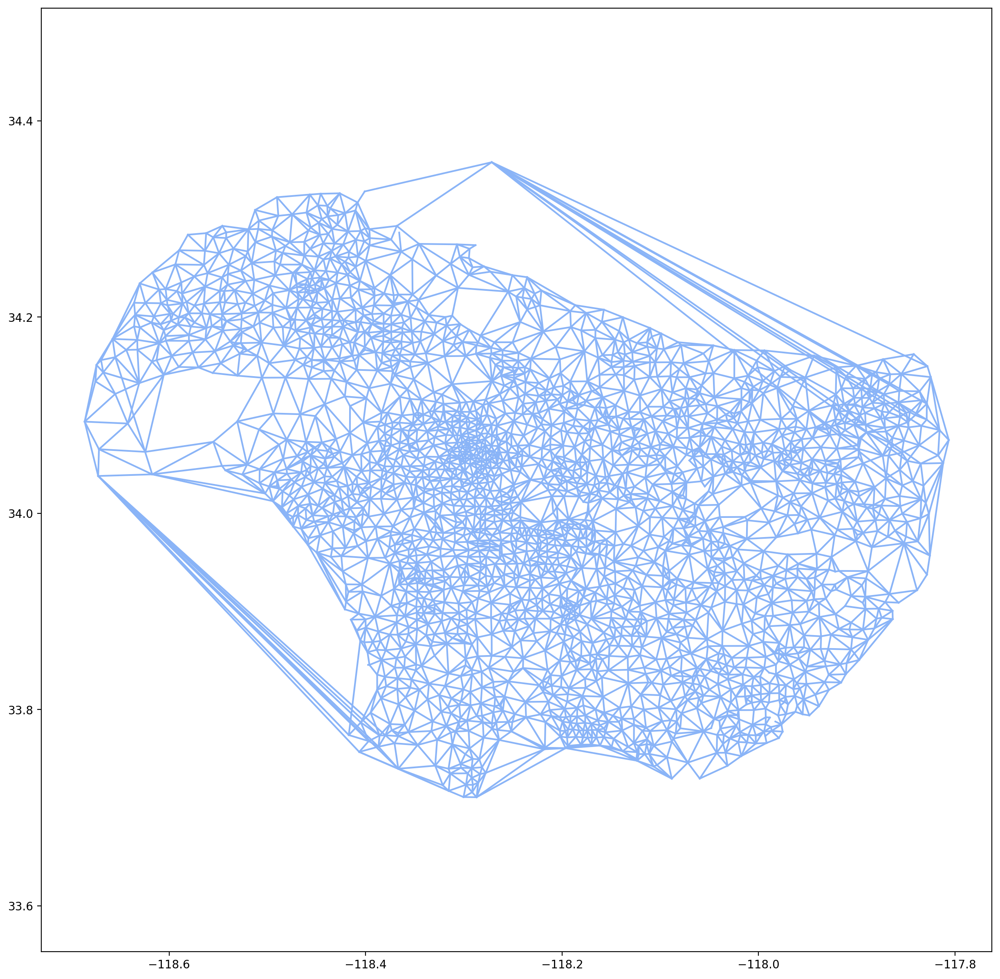

In [ ]:
# add the new_time_edges to our graph.
road_map_time_static = deepcopy(road_map_time) #ensure to use deepcopy
for edg in new_time_edges:
    start = edg[0]
    end = edg[1]
    dist = actual_geo_distances[start, end] / 69
    w = current_shortest_time[start, end] * 60 * 60
    road_map_time_static.add_edge(start, end, weight=w, geo_distance=dist)

# plot the roads and highlight our new edges.
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_time_static.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_time_static.vs[e.source]['coordinates']
    v2 = road_map_time_static.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_time_edges:
        print(cur_edge)
        plt.plot(x, y,'#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

QUESTION 22: Strategy 4 (Travel time, static): We want to optimize to reduce the maximum extra travelling time. The extra travelling distance between 2 locations is the difference of the shortest traveling time and the straight line travel time. i.e\
extra time(v,s) = travel time of shortest path(v,s) - euclidean distance(v,s)/travel speed(v,s)\
travel speed(v,s) = distance of shortest path(v,s) / travel time of shortest path(v,s)\
Use the coordinates of v and s to get the euclidean distance between them. Calculate the extra time between all pairs of points. The top 20 pairs with highest extra time will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy? What is the time complexity of the strategy?
> The resultant graph on actual coordinates is illustrated above and the time complexity of this strategy is around O(2.ElogV) + O(V2) where V is the number of vertices and E is the total number of edges. The reason for this is that we have to apply Dijkstra's shortest path algorithm 2 times to find the shortest path and shortest_time, which results in a time complexity of O(2.ElogV), and we also have to compute the travel speed by dividing the shortest path by the shortest_time, which has a time complexity of O(V2).
The top 20 pairs with highest extra distance are the following:
- Source, Destination: (1699, 1700), Extra Time: 0.61056 hr
- Source, Destination: (1699, 1860), Extra Time: 0.53256 hr
- Source, Destination: (1699, 1783), Extra Time: 0.49601 hr
- Source, Destination: (1699, 1859), Extra Time: 0.48273 hr
- Source, Destination: (1699, 1782), Extra Time: 0.46548 hr
- Source, Destination: (1700, 2416), Extra Time: 0.45792 hr
- Source, Destination: (1699, 1882), Extra Time: 0.44822 hr
- Source, Destination: (1699, 1857), Extra Time: 0.43570 hr
- Source, Destination: (2144, 2418), Extra Time: 0.43050 hr
- Source, Destination: (2052, 2418), Extra Time: 0.42573 hr
- Source, Destination: (2051, 2418), Extra Time: 0.42348 hr
- Source, Destination: (2150, 2418), Extra Time: 0.42276 hr
- Source, Destination: (1699, 1861), Extra Time: 0.42198 hr
- Source, Destination: (1901, 2418), Extra Time: 0.42049 hr
- Source, Destination: (1904, 2418), Extra Time: 0.42004 hr
- Source, Destination: (382, 2418), Extra Time: 0.41971 hr
- Source, Destination: (430, 1700), Extra Time: 0.41959 hr
- Source, Destination: (389, 2418), Extra Time: 0.41952 hr
- Source, Destination: (1699, 1881), Extra Time: 0.41942 hr
- Source, Destination: (225, 2418), Extra Time: 0.41930 hr


### QUESTION 23

In [ ]:
road_map_time_dynamic = deepcopy(road_map)

In [ ]:
actual_geo_distances = np.zeros((vcount, vcount))
for i in range(vcount):
    for j in range(i, vcount):
        v1_coor = road_map_time.vs['coordinates'][i]
        v2_coor = road_map_time.vs['coordinates'][j]
        euclidean_dist = np.sqrt((v1_coor[0]-v2_coor[0])**2+(v1_coor[1]-v2_coor[1])**2)
        actual_geo_distances[i, j] = euclidean_dist
        actual_geo_distances[j, i] = euclidean_dist

In [ ]:
budget = 20
new_dynamic_time_edges = []

print("The top 20 pairs with highest extra time:")
for iter in range(budget):
    # get the shortest time
    current_shortest_time = road_map_time_dynamic.shortest_paths(source=np.arange(vcount),
                                                                 target=np.arange(vcount),
                                                                 weights=road_map_time_dynamic.es['weight'],
                                                                 mode='all')
    current_shortest_time = np.array(current_shortest_time)

    shortest_paths = road_map_time_dynamic.shortest_paths(source=np.arange(vcount),
                                                          target=np.arange(vcount),
                                                          weights=road_map_time_dynamic.es['geo_distance'],
                                                          mode='all')
    shortest_paths = np.array(shortest_paths)
    actual_geo_distances = np.array(actual_geo_distances)

    # compute the speed in unit [miles/hr]
    current_speed = np.nan_to_num((shortest_paths*69)/(current_shortest_time/60/60))

    # compute extra time in unit [hr]
    time_diffence = (current_shortest_time/60/60) - np.nan_to_num(actual_geo_distances*69/current_speed)

    top_1 = np.argsort(time_diffence.reshape(-1))[-1]

    # get vertices of new edge to build. Build the edge and print its vertices
    row, col = int(top_1//vcount), int(top_1%vcount)
    new_edge = tuple(sorted((row, col)))
    new_dynamic_time_edges.append(new_edge)
    print("- Source, Destination: {}, Extra Time: {:.5f}".format(new_edge, time_diffence[row, col]))

    #add the new edge
    dist = actual_geo_distances[row, col]
    w = current_shortest_time[row, col]
    road_map_time_dynamic.add_edge(row, col, weight=w , geo_distance=dist)

The top 20 pairs with highest extra time:


<ipython-input-36-6778489ad469>:7: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  current_shortest_time = road_map_time_dynamic.shortest_paths(source=np.arange(vcount),
<ipython-input-36-6778489ad469>:13: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  shortest_paths = road_map_time_dynamic.shortest_paths(source=np.arange(vcount),
<ipython-input-36-6778489ad469>:21: RuntimeWarning: invalid value encountered in divide
  current_speed = np.nan_to_num((shortest_paths*69)/(current_shortest_time/60/60))
<ipython-input-36-6778489ad469>:24: RuntimeWarning: invalid value encountered in divide
  time_diffence = (current_shortest_time/60/60) - np.nan_to_num(actual_geo_distances*69/current_speed)


- Source, Destination: (1699, 1700), Extra Time: 0.61056
- Source, Destination: (2144, 2418), Extra Time: 0.43050
- Source, Destination: (2418, 2634), Extra Time: 0.40086
- Source, Destination: (2072, 2418), Extra Time: 0.39170
- Source, Destination: (1699, 1860), Extra Time: 0.37998
- Source, Destination: (311, 2418), Extra Time: 0.36396
- Source, Destination: (22, 2418), Extra Time: 0.32931
- Source, Destination: (988, 1700), Extra Time: 0.32361
- Source, Destination: (2248, 2418), Extra Time: 0.30973
- Source, Destination: (1700, 2417), Extra Time: 0.30452
- Source, Destination: (989, 1510), Extra Time: 0.27611
- Source, Destination: (507, 2418), Extra Time: 0.27074
- Source, Destination: (1699, 1781), Extra Time: 0.25922
- Source, Destination: (1860, 2417), Extra Time: 0.25646
- Source, Destination: (144, 1783), Extra Time: 0.21558
- Source, Destination: (1700, 1783), Extra Time: 0.21119
- Source, Destination: (988, 1678), Extra Time: 0.20903
- Source, Destination: (2135, 2418), Ex

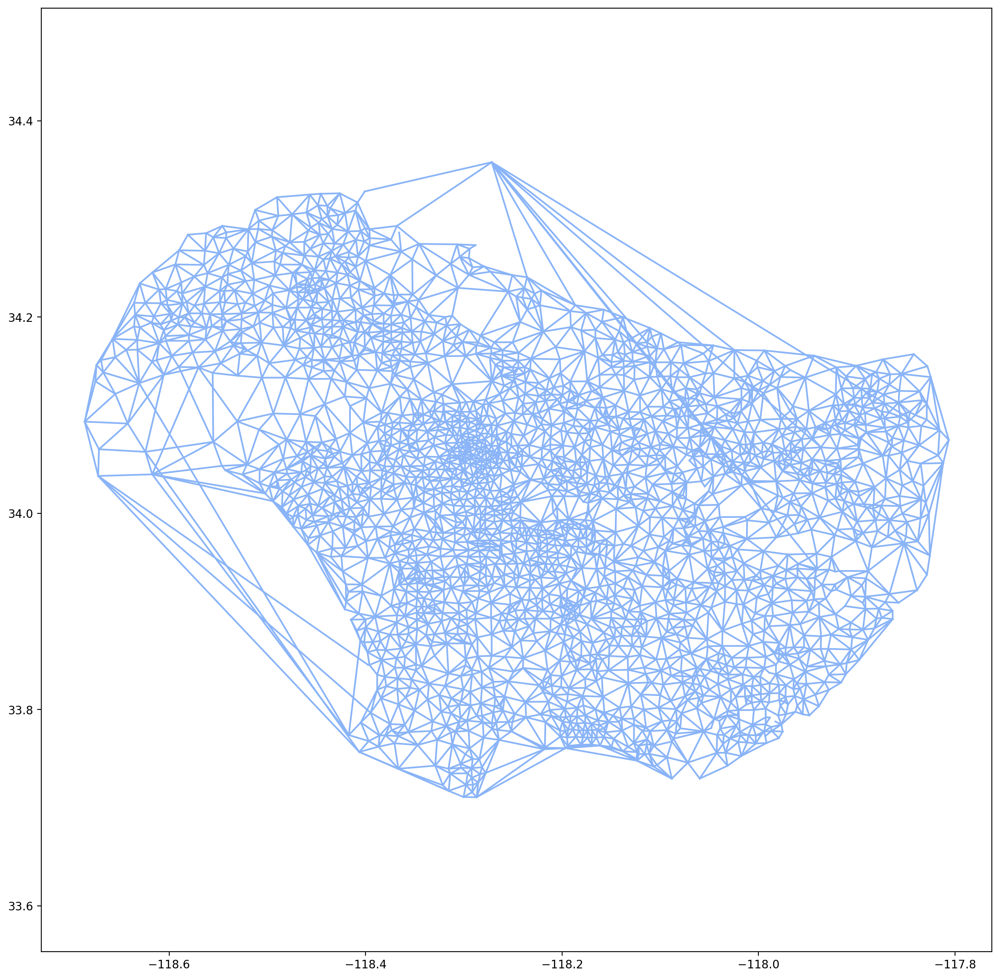

In [ ]:
# plot the roads
plt.figure(figsize=(15,15), dpi=200)
for e in road_map_time_dynamic.es:
    start = e.source
    end = e.target
    cur_edge = sorted([start,end])

    v1 = road_map_time_dynamic.vs[e.source]['coordinates']
    v2 = road_map_time_dynamic.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    if cur_edge in new_dynamic_time_edges:
        print(cur_edge)
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()

QUESTION 23: Strategy 5 (Travel time, dynamic): Similar to strategy 3, this time we will create roads one by one while optimizing the travel time.
Repeat 20 times:\
i) Compute extra time between all the pairs in the graph.\
ii) Create a road between the pair with highest extra time and update the graph.\
iii) Print the source and destination of this new edge.

Report the source and destination of the 20 new edges. plot the final graph on actual coordinates. What is the time complexity of the strategy?

> The final graph on actual coordinates is shown above. The time complexity of this algorithm is around O(N.2.ElogV) + O(N.V2), where N is the number of repeats.
The top 20 pairs with highest extra distance are the following:
- Source, Destination: (1699, 1700), Extra Time: 0.61056 hr
- Source, Destination: (2144, 2418), Extra Time: 0.43050 hr
- Source, Destination: (2418, 2634), Extra Time: 0.40086 hr
- Source, Destination: (2072, 2418), Extra Time: 0.39170 hr
- Source, Destination: (1699, 1860), Extra Time: 0.37998 hr
- Source, Destination: (311, 2418), Extra Time: 0.36396 hr
- Source, Destination: (22, 2418), Extra Time: 0.32931 hr
- Source, Destination: (988, 1700), Extra Time: 0.32361 hr
- Source, Destination: (2248, 2418), Extra Time: 0.30973 hr
- Source, Destination: (1700, 2417), Extra Time: 0.30452 hr
- Source, Destination: (989, 1510), Extra Time: 0.27611 hr
- Source, Destination: (507, 2418), Extra Time: 0.27074 hr
- Source, Destination: (1699, 1781), Extra Time: 0.25922 hr
- Source, Destination: (1860, 2417), Extra Time: 0.25646 hr
- Source, Destination: (144, 1783), Extra Time: 0.21558 hr
- Source, Destination: (1700, 1783), Extra Time: 0.21119 hr
- Source, Destination: (988, 1678), Extra Time: 0.20903 hr
- Source, Destination: (2135, 2418), Extra Time: 0.19896 hr
- Source, Destination: (1699, 2402), Extra Time: 0.19655 hr
- Source, Destination: (1005, 1510), Extra Time: 0.18877 hr



### QUESTION 24

QUESTION 24: Strategy comparison. Compare the following strategies:\
a) 1 vs 2 - compare and analyze the results. which is better? why?\
b) 1 vs 3 - compare and analyze the results. which is better? why?\
c) 1 vs 4 - compare and analyze the results. which is better? why?\
d) statics vs dynamic - Considering we want to improve the overall road network by constructing new roads, is either of them the optimal strategy?\
i) if yes, which one and why?\
ii) if not, what would be a better strategy to construct roads and is it optimal? What is the time complexity?
(assume that you want to reduce travelling distances and you know before hand that we have to construct 20 new roads).\
e) Open ended question : Come up with new strategy. You are free to make any assumptions. You don’t have to necessarily optimize traveling time or distance, you can come up with any constraints. justify your strategy.

> a) There isn't a huge difference between the result of strategy 1 and 2 according to the plots shown above. Basically, most of the new edges we suggest are related to the node 2418 and connects to other nodes, which is mostly on the other side across the mountain area. However, after a closer look, one can notice that with strategy 2, those nodes besides the node 2418 spread wider to different areas/cities. Hence, we can say that strategy 2 is better compared to strategy 1 as the 20 new edges generated through this method spread to more area, which is in general better than having 20 new edges connecting the same area.

> b) It is obvious that strategy 3 is hugely better than strategy 1. From the plots, one can see that with strategy 3, the 20 new generated roads successfully connect various different areas and cities, unlike strategy 1 which mostly connects to 2418 in the mountain area. We can see that there are new roads like highways that directly connect cities across the ocean, mountain area, and north-west side of LA to the south-east side of LA. This high variety of connections will definitely benefit the city more than the suggestion roads generated by strategy 1. Moreover, from the reported value of extra distance generated at the end of each algorithm, we can see that after strategy 3, the maximal extra distance is only 0.06455 X 69 =4.45395 miles, which is way smaller than the maximal extra distance after strategy 1, which is 0.19336 X 69 = 13.34184 miles. Therefore, strategy 3 is better.

> c) Based on the plots, we can see that the strategy 4 is better than the strategy 1 as it recognizes not only the need of new roads to directly connect the mountain area (node 2418) to other cities on the other side of the mountain but also the better direct solution to travel from Malibu to other cities by building highways across the ocean to reduce the total time to travel from any point in LA to another point.

> d) Generally speaking, dynamic strategy is better than statics strategy if we considering the improvement of the overall road network by constructing new roads, which can be proven based on both maximal extra distance (dynamic vs. statics: 4.45 miles vs. 13.34 miles) or maximal extra time (dynamic vs. statics: 0.19 hr vs. 0.42 hr) after 20 new roads construction. However, even though the dynamic strategy is better, it is not the optimal strategy because it doesn't consider the reality of such construction such as the cost, safety, feasibility, time, etc. A better strategy would be to take all of the aforementioned reality factors into consideration. However, this will results in a very high time complexity at least O(N.M.ElogV) where N is the number of new road to construct and M is the number of reality factors that we need to use Dijkstra's shortest path algorithm O(ElogV) to find the optimal value. V is the number of vertices and E is the total number of edges. If there is further calculation needed such as computing the weights between each factor or other mathematical formulation, then the time complexity will even increase to a higher value. For example, adding matrix multiplication at the end of each road construction decision will result in increasing the time complexity by O(N.V2).

> e) An intuitive idea is a dynamic strategy to optimize between the pros and cons of constructing the new road. The pros are, for instance, less time and distance to travel and the cons are the cost of such roads such as time to construct and money. In order to optimize this, we have to come up with an objective function that combines both pros and cons in some mathematical formulation or some weight factors to balance the importance among each factor. Other constraints might also need to be introduced to make such a decision of construction feasible. With such an idea and algorithm, I think we can find the optimal road to construct.

